# combine features and results display

In [1]:
import pandas as pd
import numpy as np
import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
import seaborn as sns
import plotly.express as px

In [2]:
dtype={'wagon_ID': str,
       'loading_state': str,
       'loading_state_update': str,
       'altitude': np.float16,
       'latitude': np.float32,
       'longitude': np.float32,
       'signal_quality_satellite': np.float32,
       'signal_quality_hdop': np.float32,
       'determination_position': np.uint8,
       'GNSS_velocity': np.float16,
       'timestamp_measure_position': str,
       'timestamp_transfer': str,
       'movement_state': str,
       'timestamp_measure_movement_state': str,
       'timestamp_index': str,
       'provider': np.uint8,
       'ratio_x_new': np.float32}

# read csv
df1 = pd.read_csv('ratio01.csv', dtype=dtype)
df2 = pd.read_csv('feature_sv.csv', dtype=dtype)
df3 = pd.read_csv('feature_timegap.csv', dtype=dtype)

In [3]:
# Merge three Dataframe
df = pd.merge(df1, df2, how='outer', on=['wagon_ID', 'latitude', 'longitude', 'timestamp_measure_position'])
df_sum = pd.merge(df, df3, how='outer', on=['wagon_ID', 'latitude', 'longitude', 'timestamp_measure_position'])

In [4]:
# preprocessing
df_sum.dropna(how='any', inplace=True)
df_sum

,wagon_ID,latitude,longitude,timestamp_measure_position,ratio_x_new,velocity_distance_Normalization,Unnamed: 0,time_gap
0,'1176603744306948',49.416363,11.101607,9 days 17:27:10,1.0,1.0,2136136,0.5
1,'1176603744306948',49.416363,11.101607,9 days 21:43:10,1.0,1.0,2136140,0.5
2,'1176603744306948',49.416363,11.101607,9 days 18:31:10,1.0,1.0,2136137,0.5
3,'1176603744306948',49.416363,11.101607,9 days 22:47:11,1.0,1.0,2136141,0.5
4,'1176603744306948',49.416363,11.101607,9 days 20:39:10,1.0,1.0,2136139,0.5
...,...,...,...,...,...,...,...,...
4947730,'1017603232983914',50.011662,10.215717,3 days 14:50:42,0.0,0.0,38940,1.0
4947731,'1017603232983914',50.034683,10.218106,3 days 14:54:07,0.0,1.0,38941,1.0
4947732,'1017603232983914',50.026054,10.197790,4 days 05:18:54,0.0,0.0,38945,1.0
4947734,'1017603232983914',50.026215,10.197792,3 days 15:07:35,0.0,0.0,38944,1.0


In [5]:
# Extract the useful columns and create a 2Darray
df5 = df_sum[['ratio_x_new','velocity_distance_Normalization','time_gap']]
df_matrix = df5.values

In [6]:
# Check the correlation between the features
df5.corr()

,ratio_x_new,velocity_distance_Normalization,time_gap
ratio_x_new,1.000000,-0.072342,0.052208
velocity_distance_Normalization,-0.072342,1.000000,-0.084914
time_gap,0.052208,-0.084914,1.000000


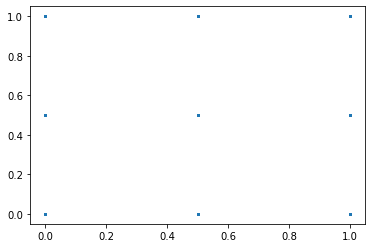

In [7]:
plt.scatter(df5['ratio_x_new'], df5['time_gap'], s =1)

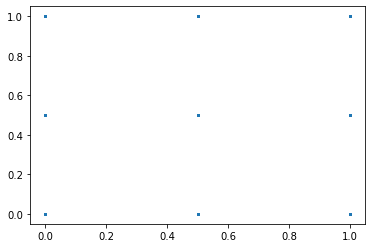

In [8]:
plt.scatter(df5['ratio_x_new'], df5['velocity_distance_Normalization'], s =1)

In [9]:
# Dimensionality reduction for three features into two features
result1,result2 = PCA.pca(df_matrix,2)

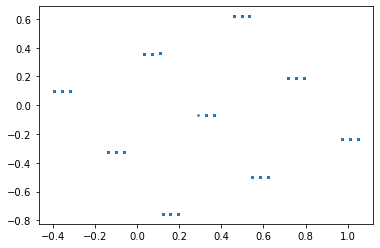

In [10]:
fig = plt.figure()
plt.scatter(result1[:,0], result1[:,1],s=1)

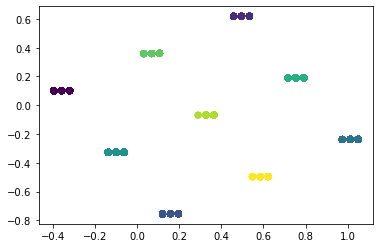

In [11]:
X = result1
k_means = KMeans(init='k-means++', n_clusters=9, n_init=10,random_state=10)
y_pred = k_means.fit_predict(X)
plt.scatter(X[:, 0], X[:, 1], c=y_pred)
plt.show()

According to pca's analysis, we analyzed the coordinates and meaning of each point. 'time_gap' carries the least information. So we give a weight of 0.6, 0.3, 0.1 to each feature.

In [12]:
df_sum['quality'] = 0.6 * df_sum['velocity_distance_Normalization'] + 0.3 * df_sum['ratio_x_new'] + 0.1 * df_sum['time_gap']

In [13]:
del(df, df1, df2, df3)

In [14]:
df = df_sum.sample(frac=0.05)
fig = px.scatter_mapbox(df, lat='latitude', lon='longitude', height=800, color='quality')
fig.update_layout(mapbox_style="white-bg",
                  mapbox_layers=[
                        {
                        "below": 'traces',
                        "sourcetype": "raster",
                        "sourceattribution": "OpenRailwayMap",
                        "source": ["https://a.tiles.openrailwaymap.org/standard/{z}/{x}/{y}.png"]
                        }
                                ]
                 )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()